# Problem Statement

Task 1:-Prepare a complete data analysis report on the given data.

Task 2:- Explore football skills and cluster football players based on their attributes.

Task3:- Explore the data and attempt all the below asked questions in a
step by step manner:
   *  Prepare a rank ordered list of top 10 countries with most players. Which countries are producing the most footballers that play at this level?
   *   Plot the distribution of overall rating vs. age of players. Interpret what is the age after which a player stops improving?
   *   Which type of offensive players tends to get paid the most: the striker, the right-winger, or the left-winger?




In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")




In [2]:
from google.colab import drive
drive.mount("/content/gdrive")

Mounted at /content/gdrive


In [3]:
data=pd.read_csv('/content/gdrive/My Drive/capstone project/fifa_20/players_20.csv')

# 2)Basic checks

In [4]:
data.head()

,sofifa_id,player_url,short_name,long_name,age,dob,height_cm,weight_kg,nationality,club,...,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb
0,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,32,1987-06-24,170,72,Argentina,FC Barcelona,...,68+2,66+2,66+2,66+2,68+2,63+2,52+2,52+2,52+2,63+2
1,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,34,1985-02-05,187,83,Portugal,Juventus,...,65+3,61+3,61+3,61+3,65+3,61+3,53+3,53+3,53+3,61+3
2,190871,https://sofifa.com/player/190871/neymar-da-sil...,Neymar Jr,Neymar da Silva Santos Junior,27,1992-02-05,175,68,Brazil,Paris Saint-Germain,...,66+3,61+3,61+3,61+3,66+3,61+3,46+3,46+3,46+3,61+3
3,200389,https://sofifa.com/player/200389/jan-oblak/20/...,J. Oblak,Jan Oblak,26,1993-01-07,188,87,Slovenia,Atlético Madrid,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,183277,https://sofifa.com/player/183277/eden-hazard/2...,E. Hazard,Eden Hazard,28,1991-01-07,175,74,Belgium,Real Madrid,...,66+3,63+3,63+3,63+3,66+3,61+3,49+3,49+3,49+3,61+3


In [5]:
data.tail()

,sofifa_id,player_url,short_name,long_name,age,dob,height_cm,weight_kg,nationality,club,...,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb
18273,245006,https://sofifa.com/player/245006/shuai-shao/20...,Shao Shuai,邵帅,22,1997-03-10,186,79,China PR,Beijing Renhe FC,...,43+2,42+2,42+2,42+2,43+2,45+2,46+2,46+2,46+2,45+2
18274,250995,https://sofifa.com/player/250995/mingjie-xiao/...,Xiao Mingjie,Mingjie Xiao,22,1997-01-01,177,66,China PR,Shanghai SIPG FC,...,44+2,43+2,43+2,43+2,44+2,46+2,47+2,47+2,47+2,46+2
18275,252332,https://sofifa.com/player/252332/wei-zhang/20/...,Zhang Wei,张威,19,2000-05-16,186,75,China PR,Hebei China Fortune FC,...,47+2,49+2,49+2,49+2,47+2,47+2,49+2,49+2,49+2,47+2
18276,251110,https://sofifa.com/player/251110/haijian-wang/...,Wang Haijian,汪海健,18,2000-08-02,185,74,China PR,Shanghai Greenland Shenhua FC,...,48+2,48+2,48+2,48+2,48+2,48+2,49+2,49+2,49+2,48+2
18277,233449,https://sofifa.com/player/233449/ximing-pan/20...,Pan Ximing,潘喜明,26,1993-01-11,182,78,China PR,Hebei China Fortune FC,...,48+2,49+2,49+2,49+2,48+2,48+2,50+2,50+2,50+2,48+2


In [6]:
data.shape

(18278, 104)

In [7]:
print(list(data.columns))

['sofifa_id', 'player_url', 'short_name', 'long_name', 'age', 'dob', 'height_cm', 'weight_kg', 'nationality', 'club', 'overall', 'potential', 'value_eur', 'wage_eur', 'player_positions', 'preferred_foot', 'international_reputation', 'weak_foot', 'skill_moves', 'work_rate', 'body_type', 'real_face', 'release_clause_eur', 'player_tags', 'team_position', 'team_jersey_number', 'loaned_from', 'joined', 'contract_valid_until', 'nation_position', 'nation_jersey_number', 'pace', 'shooting', 'passing', 'dribbling', 'defending', 'physic', 'gk_diving', 'gk_handling', 'gk_kicking', 'gk_reflexes', 'gk_speed', 'gk_positioning', 'player_traits', 'attacking_crossing', 'attacking_finishing', 'attacking_heading_accuracy', 'attacking_short_passing', 'attacking_volleys', 'skill_dribbling', 'skill_curve', 'skill_fk_accuracy', 'skill_long_passing', 'skill_ball_control', 'movement_acceleration', 'movement_sprint_speed', 'movement_agility', 'movement_reactions', 'movement_balance', 'power_shot_power', 'power_

In [8]:

float_data = data.select_dtypes('float')
int_data = data.select_dtypes('integer')
obj_data = data.select_dtypes('object')

In [9]:
float_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18278 entries, 0 to 18277
Data columns (total 16 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   release_clause_eur    16980 non-null  float64
 1   team_jersey_number    18038 non-null  float64
 2   contract_valid_until  18038 non-null  float64
 3   nation_jersey_number  1126 non-null   float64
 4   pace                  16242 non-null  float64
 5   shooting              16242 non-null  float64
 6   passing               16242 non-null  float64
 7   dribbling             16242 non-null  float64
 8   defending             16242 non-null  float64
 9   physic                16242 non-null  float64
 10  gk_diving             2036 non-null   float64
 11  gk_handling           2036 non-null   float64
 12  gk_kicking            2036 non-null   float64
 13  gk_reflexes           2036 non-null   float64
 14  gk_speed              2036 non-null   float64
 15  gk_positioning     

In [10]:
int_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18278 entries, 0 to 18277
Data columns (total 45 columns):
 #   Column                      Non-Null Count  Dtype
---  ------                      --------------  -----
 0   sofifa_id                   18278 non-null  int64
 1   age                         18278 non-null  int64
 2   height_cm                   18278 non-null  int64
 3   weight_kg                   18278 non-null  int64
 4   overall                     18278 non-null  int64
 5   potential                   18278 non-null  int64
 6   value_eur                   18278 non-null  int64
 7   wage_eur                    18278 non-null  int64
 8   international_reputation    18278 non-null  int64
 9   weak_foot                   18278 non-null  int64
 10  skill_moves                 18278 non-null  int64
 11  attacking_crossing          18278 non-null  int64
 12  attacking_finishing         18278 non-null  int64
 13  attacking_heading_accuracy  18278 non-null  int64
 14  attack

In [11]:
obj_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18278 entries, 0 to 18277
Data columns (total 43 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   player_url        18278 non-null  object
 1   short_name        18278 non-null  object
 2   long_name         18278 non-null  object
 3   dob               18278 non-null  object
 4   nationality       18278 non-null  object
 5   club              18278 non-null  object
 6   player_positions  18278 non-null  object
 7   preferred_foot    18278 non-null  object
 8   work_rate         18278 non-null  object
 9   body_type         18278 non-null  object
 10  real_face         18278 non-null  object
 11  player_tags       1499 non-null   object
 12  team_position     18038 non-null  object
 13  loaned_from       1048 non-null   object
 14  joined            16990 non-null  object
 15  nation_position   1126 non-null   object
 16  player_traits     7566 non-null   object
 17  ls          

In [12]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
sofifa_id,18278.0,219738.864482,27960.200461,768.0,204445.5,226165.0,240795.75,252905.0
age,18278.0,25.283291,4.656964,16.0,22.0,25.0,29.00,42.0
height_cm,18278.0,181.362184,6.756961,156.0,177.0,181.0,186.00,205.0
weight_kg,18278.0,75.276343,7.047744,50.0,70.0,75.0,80.00,110.0
overall,18278.0,66.244994,6.949953,48.0,62.0,66.0,71.00,94.0
...,...,...,...,...,...,...,...,...
goalkeeping_diving,18278.0,16.572765,17.738069,1.0,8.0,11.0,14.00,90.0
goalkeeping_handling,18278.0,16.354853,16.996925,1.0,8.0,11.0,14.00,92.0
goalkeeping_kicking,18278.0,16.212934,16.613665,1.0,8.0,11.0,14.00,93.0
goalkeeping_positioning,18278.0,16.368038,17.136497,1.0,8.0,11.0,14.00,91.0


In [13]:
data.describe(include=['O']).T

,count,unique,top,freq
player_url,18278,18278,https://sofifa.com/player/158023/lionel-messi/...,1
short_name,18278,17354,J. Rodríguez,11
long_name,18278,18218,Liam Kelly,3
dob,18278,6142,1992-02-29,113
nationality,18278,162,England,1667
club,18278,698,FC Barcelona,33
player_positions,18278,643,CB,2322
preferred_foot,18278,2,Right,13960
work_rate,18278,9,Medium/Medium,9875
body_type,18278,10,Normal,10750


In [14]:
nulldata=pd.DataFrame(data.isnull().sum())
nulldata

,0
sofifa_id,0
player_url,0
short_name,0
long_name,0
age,0
...,...
lb,2036
lcb,2036
cb,2036
rcb,2036


**Domain Analysis**
* Aim: cluster the players based on using their whole skillset.
* There are a total of 18278 rows with 104 columns of which 16 columns are of datatype float, 45 columns are of datatype integer, 43 features are of datatype object
* In 104 columns most of them are not important for model building and some of them are important at the eda and preprocessing process
* Around 44 fields having null values and some features are having around 80% of null data

# 3) EDA

In [184]:
!pip install sweetviz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.1/15.1 MB 19.5 MB/s eta 0:00:00


In [185]:
import sweetviz as sv#importing sweetviz library
my_report = sv.analyze(data)#syntax to use sweetviz
my_report.show_html()

                                             |          | [  0%]   00:00 -> (? left)

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.



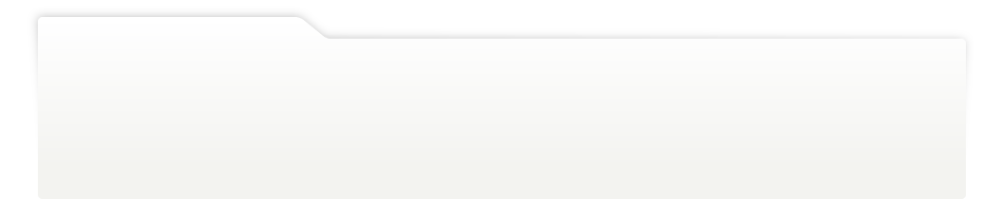
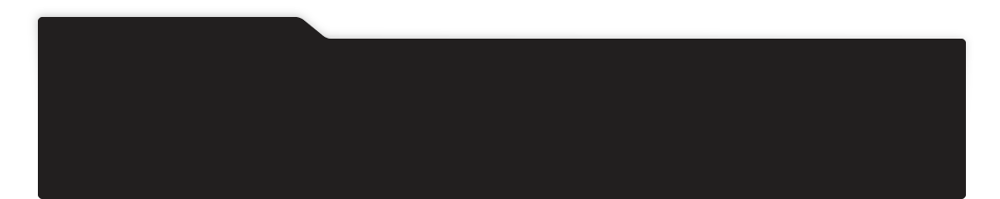
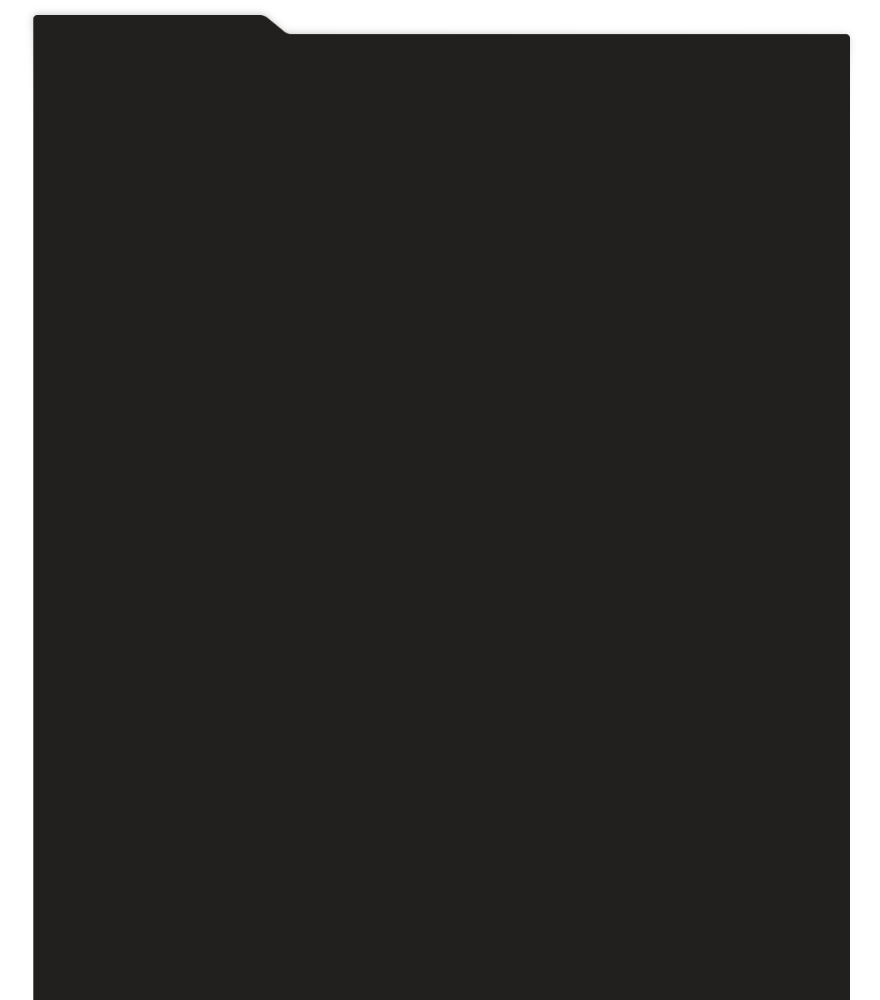
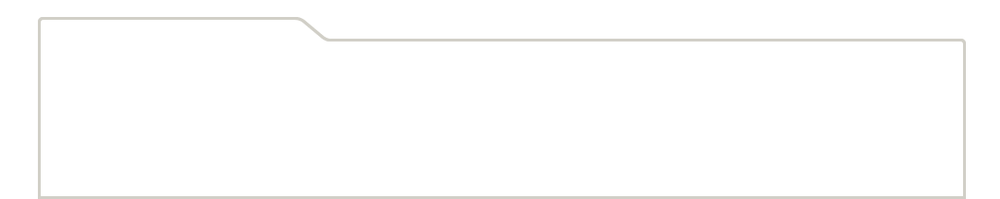
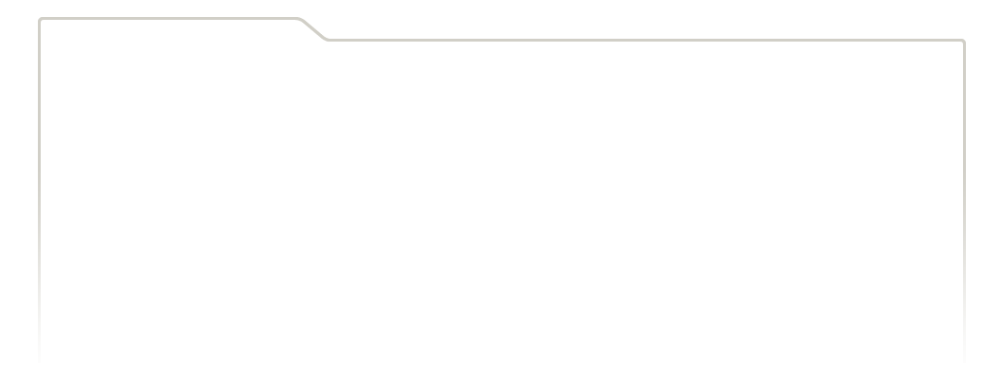
...
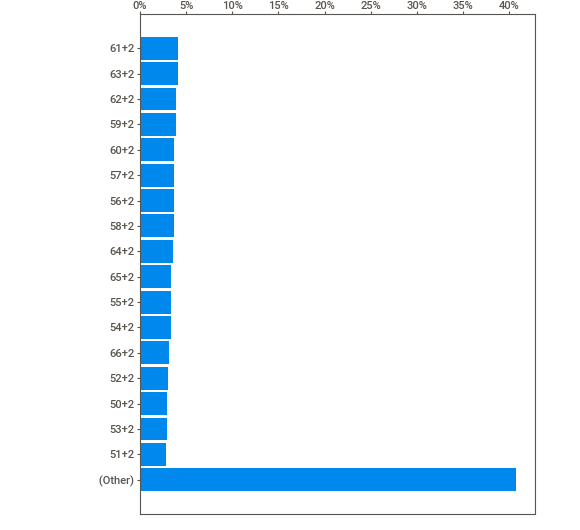
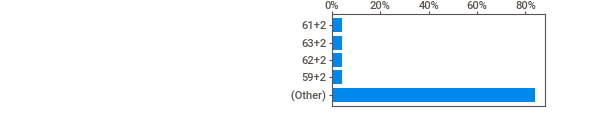
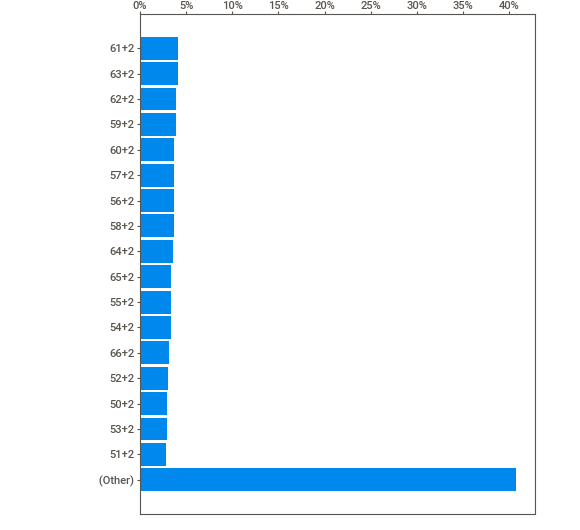
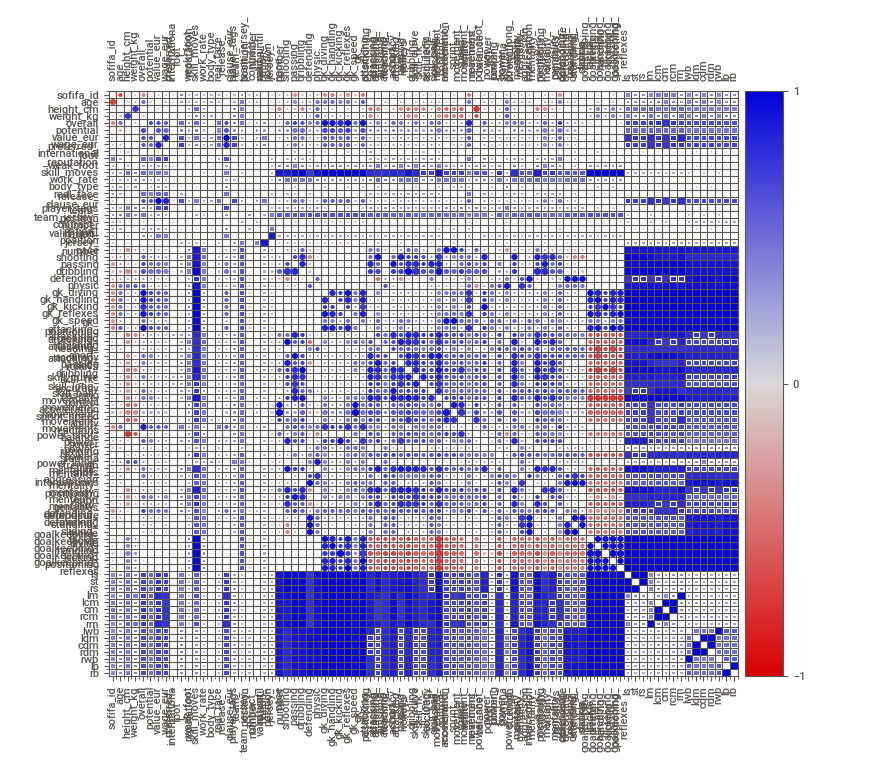
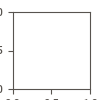

Report '/content/SWEETVIZ_REPORT.html' was saved to storage.


In [186]:
my_report.show_notebook(w=None, h=None,scale=None,
                         layout='vertical',
                          filepath='/content/SWEETVIZ_REPORT.html')

* some numerical data are skewed others are normally distributed
* In some features morethan 80% of data are missing
* value_eur and wage_eur contains value zero
* 24% of players preferred left foot
* In workrate 54% is medium for both AttackWorkRate and DefenseWorkRate; 18%  high/medium  and 8%  medium/high for AttackWorkRate and DefenseWorkRate respectively
* 59% have normal body type


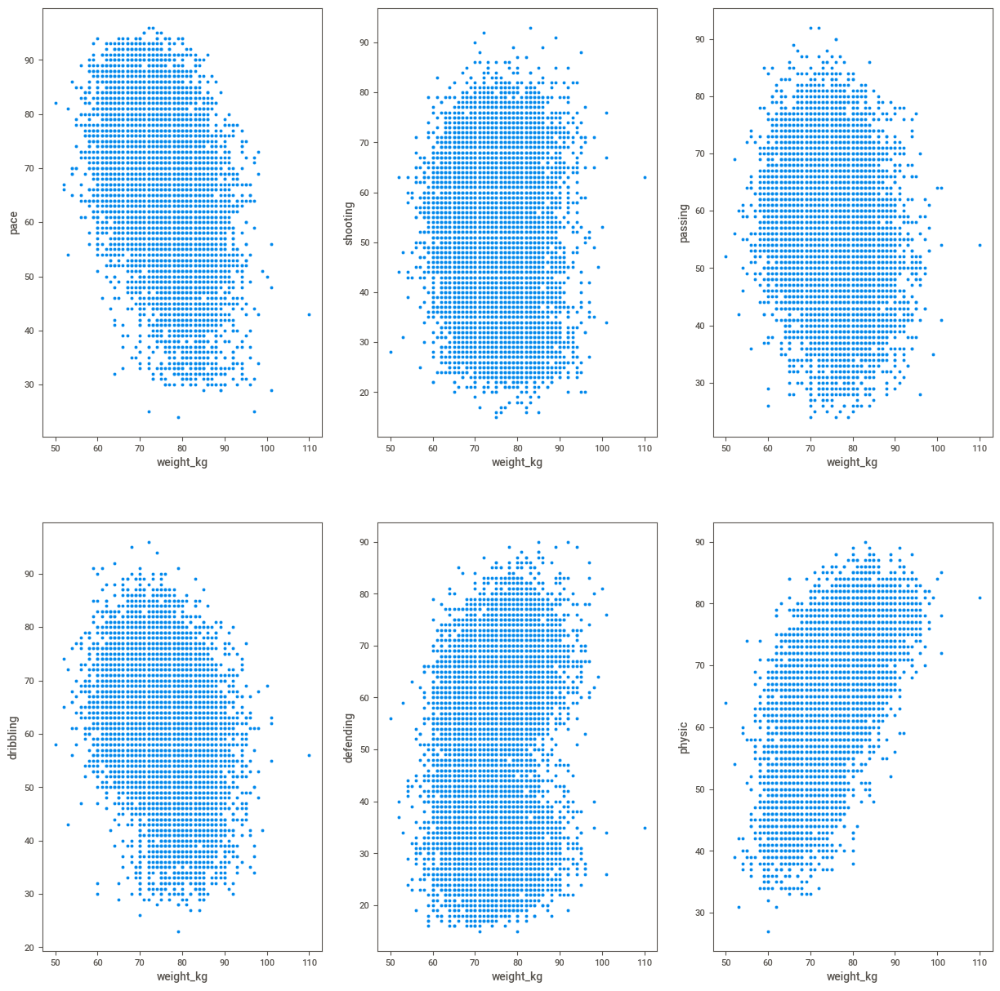

In [187]:
plt.figure(figsize=(15,15))
plt_num = 1

cols = ["pace", "shooting", "passing", "dribbling", "defending", "physic"]

for c in cols:
    if plt_num <= 6:
        plt.subplot(2,3,plt_num)
        sns.scatterplot(x="weight_kg", y=c, data=data)
    plt_num += 1
plt.show()

* Weight above morethan 90 have good physic
* expect foe few players ,who weigh 90 and above are slow in pace", "shooting", "passing", "dribbling", "defending" these skills

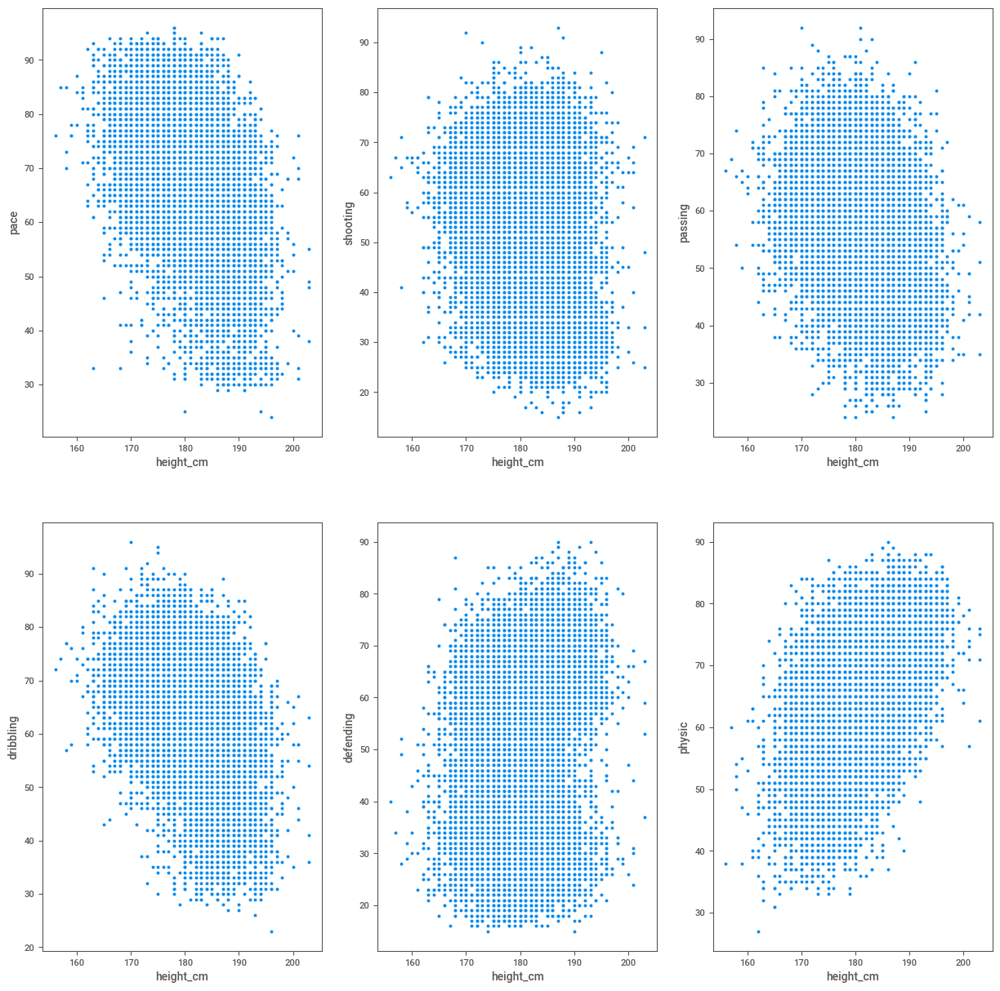

In [188]:
plt.figure(figsize=(15,15))
plt_num = 1

cols = ["pace", "shooting", "passing", "dribbling", "defending", "physic"]

for c in cols:
    if plt_num <= 6:
        plt.subplot(2,3,plt_num)
        sns.scatterplot(x="height_cm", y=c, data=data)
    plt_num += 1
plt.show()

* Players with height between 170 to 200 cm tend to have a good physic ranking and defending skill
* as the height increases morethan 190: -->their pace, passing and dribbling skills get decreased and only some of them have good shooting skill  



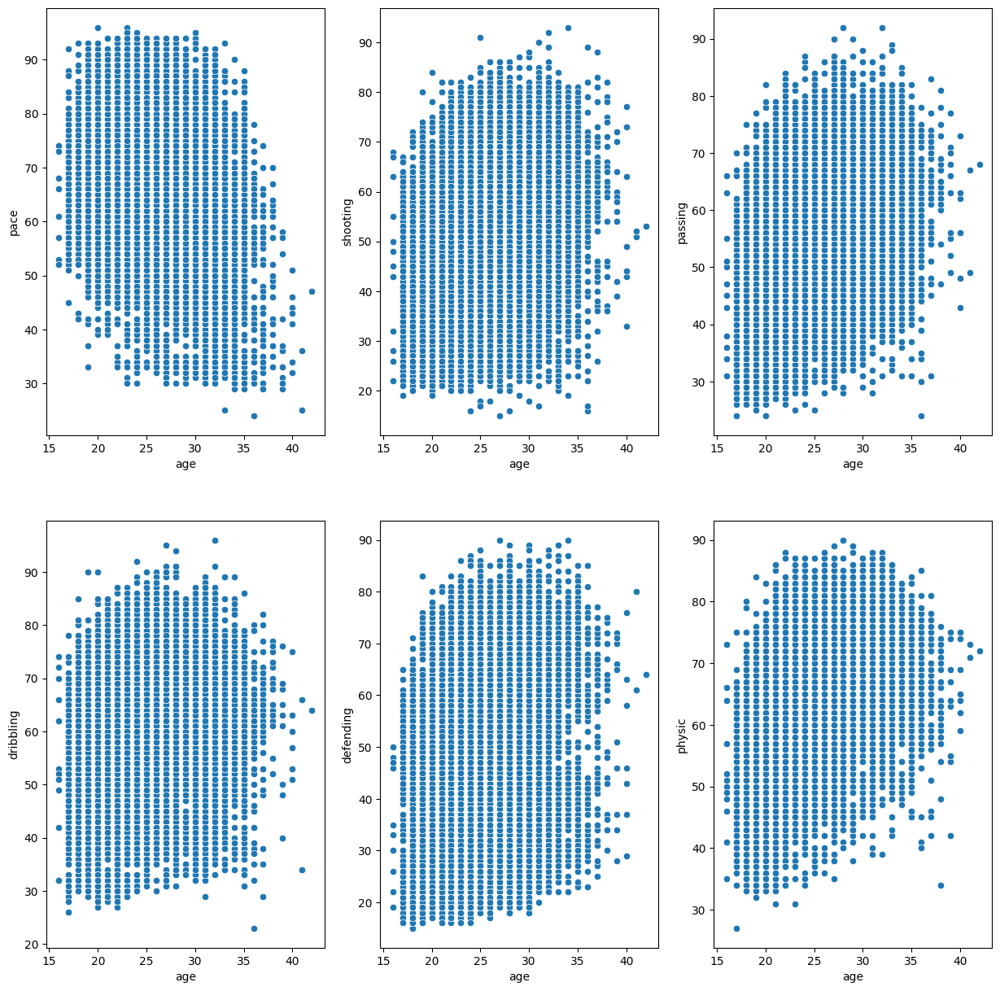

In [4]:
plt.figure(figsize=(15,15))
plt_num = 1

cols = ["pace", "shooting", "passing", "dribbling", "defending", "physic"]

for c in cols:
    if plt_num <= 6:
        plt.subplot(2,3,plt_num)
        sns.scatterplot(x="age", y=c, data=data)
    plt_num += 1
plt.show()

* players age is depending on these skilla and physic as the age increases these skills get decreases

<Axes: xlabel='preferred_foot', ylabel='body_type'>

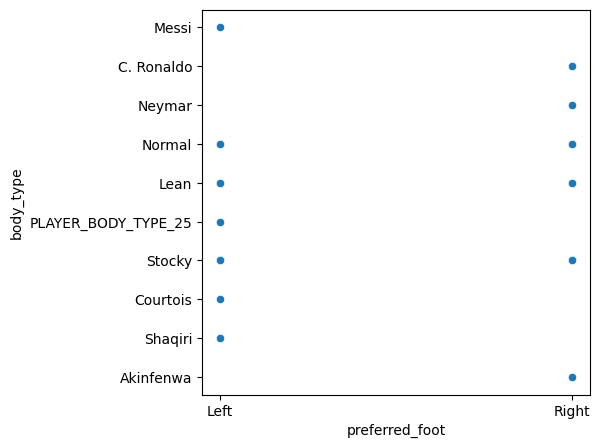

In [33]:
  plt.figure(figsize=(5,5))
  sns.scatterplot( data=data, y='body_type',x='preferred_foot')


<Axes: xlabel='wage_eur', ylabel='potential'>

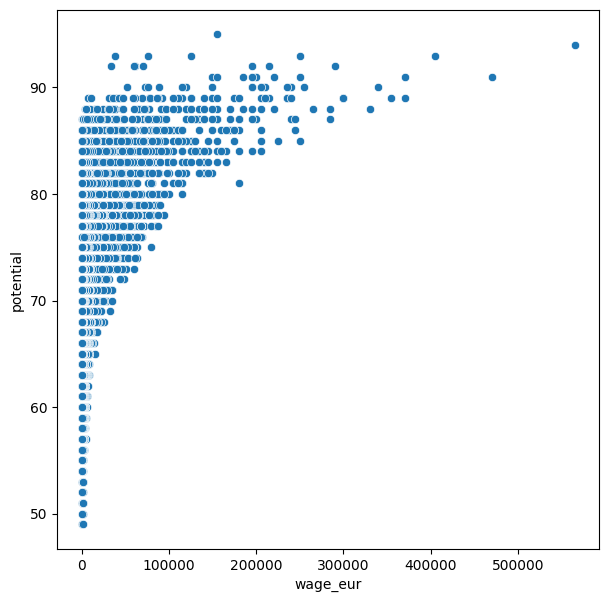

In [15]:
  plt.figure(figsize=(7,7))
  sns.scatterplot( data=data, x='wage_eur',y='potential')

<Axes: xlabel='wage_eur', ylabel='overall'>

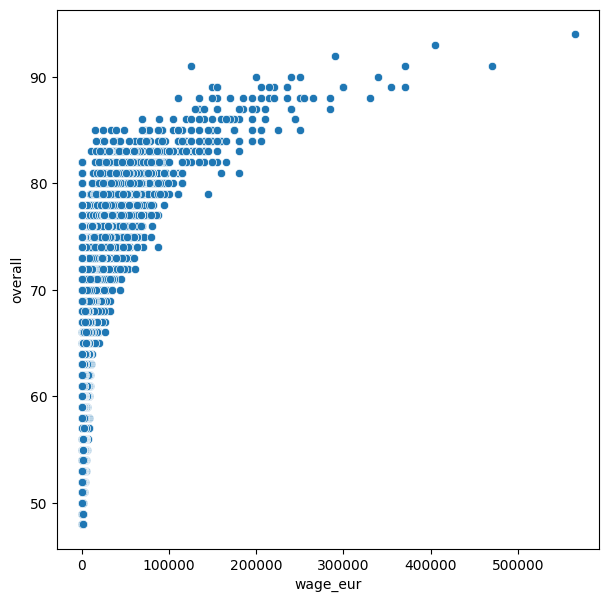

In [ ]:
  plt.figure(figsize=(7,7))
  sns.scatterplot( data=data, x='wage_eur',y='overall')

* As the  players overall performance and potential increases the wage is also increasing for the players

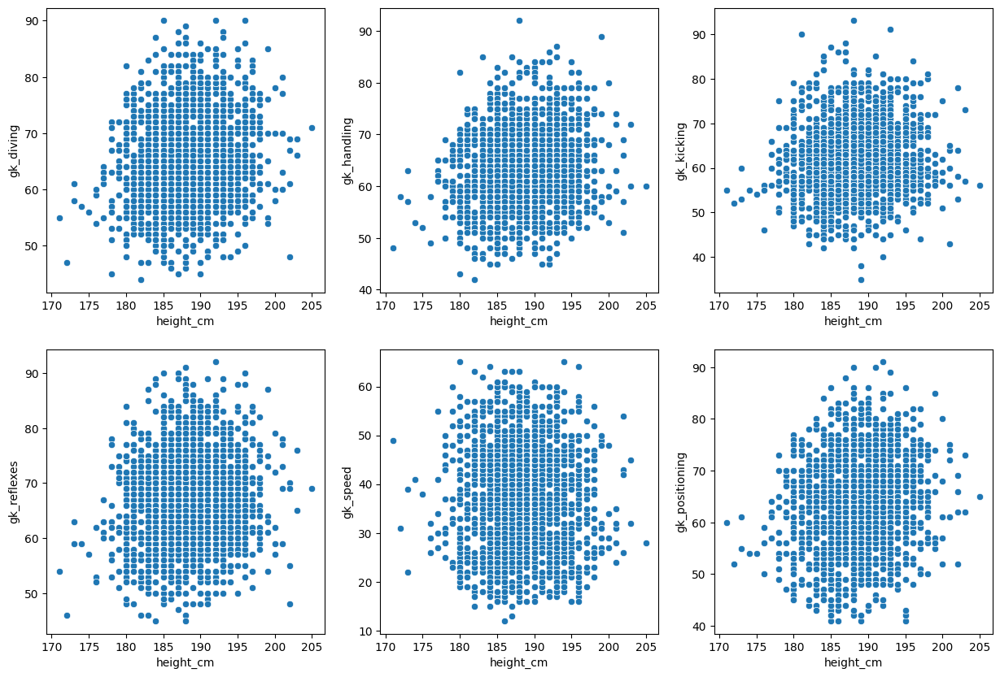

In [18]:
plt.figure(figsize=(15,10))
plt_num = 1

cols = ['gk_diving','gk_handling','gk_kicking' ,'gk_reflexes','gk_speed','gk_positioning']

for c in cols:
    if plt_num <= 6:
        plt.subplot(2,3,plt_num)
        sns.scatterplot(x="height_cm", y=c, data=data)
    plt_num += 1
plt.show()

The performance of goal keepers decreases  from height above 195  

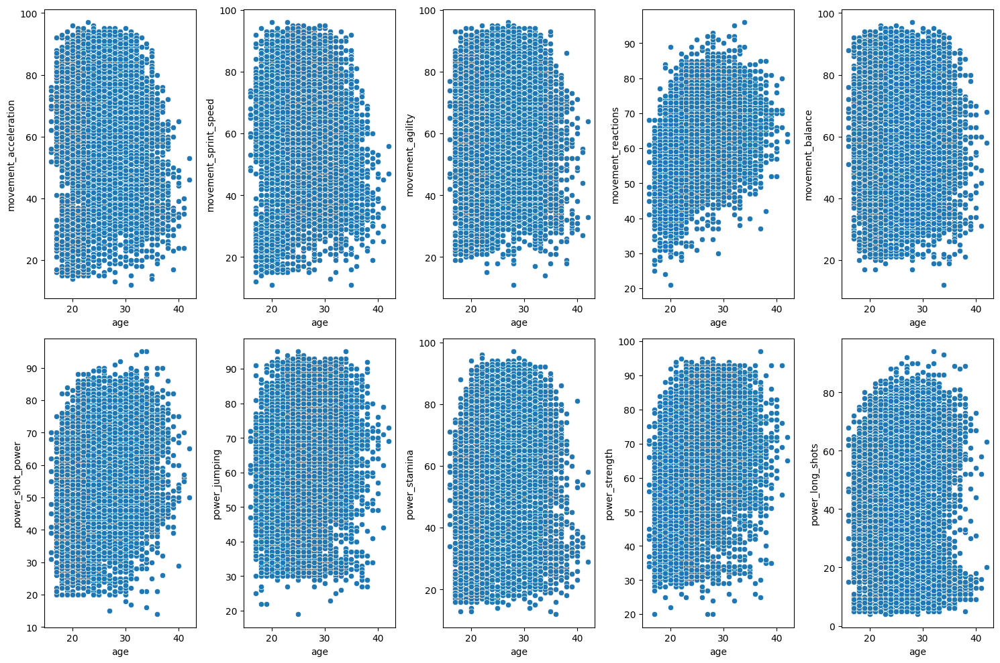

In [26]:
plt.figure(figsize=(15,10))
plt_num = 1

cols = ['movement_acceleration', 'movement_sprint_speed', 'movement_agility','movement_reactions','movement_balance','power_shot_power',
        'power_jumping','power_stamina','power_strength','power_long_shots' ]

for c in cols:
    if plt_num <= 10:
        plt.subplot(2,5,plt_num)
        sns.scatterplot(x="age", y=c, data=data)
    plt_num += 1
plt.tight_layout()
plt.show()


 * Age is a important factor for a player, in here we can see that how the  movement_reactions is increases according to the age;Even after the  40 it decreases in between 60 to  80
 * 'movement_acceleration', 'movement_sprint_speed', 'movement_agility','','movement_balance','power_shot_power',power_jumping','power_stamina','power_strength','power_long_shots' these skills decreases as the age after 35

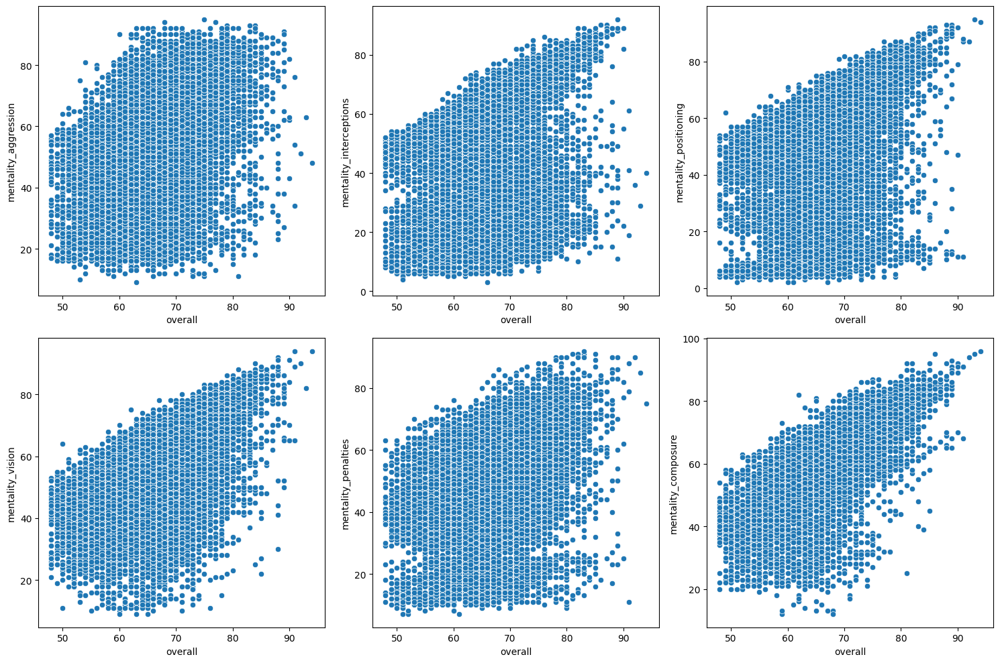

In [28]:
plt.figure(figsize=(15,10))
plt_num = 1

cols = ['mentality_aggression','mentality_interceptions','mentality_positioning','mentality_vision', 'mentality_penalties', 'mentality_composure' ]

for c in cols:
    if plt_num <= 6:
        plt.subplot(2,3,plt_num)
        sns.scatterplot(x="overall", y=c, data=data)
    plt_num += 1
plt.tight_layout()
plt.show()



*
 'mentality_aggression','mentality_interceptions',mentality_positioning''mentality_vision', 'mentality_penalties', 'mentality_composure' these are very important for each player

Qn) Prepare a rank ordered list of top 10 countries with most players. Which countries are producing the most footballers that play at this level?
     


In [189]:
n=data['nationality'].value_counts()
n.head(10)

England        1667
Germany        1216
Spain          1035
France          984
Argentina       886
Brazil          824
Italy           732
Colombia        591
Japan           453
Netherlands     416
Name: nationality, dtype: int64

Countries that produce the most football players are :

1)England 2)Germany 3)Spain 4)France 5)Argentina 6)Brazil 7)Italy 8)Colombia 9)Japan 10)Netherlands

Qn: Plot the distribution of overall rating vs. age of players. Interpret what is the age after which a player stops improving?
    

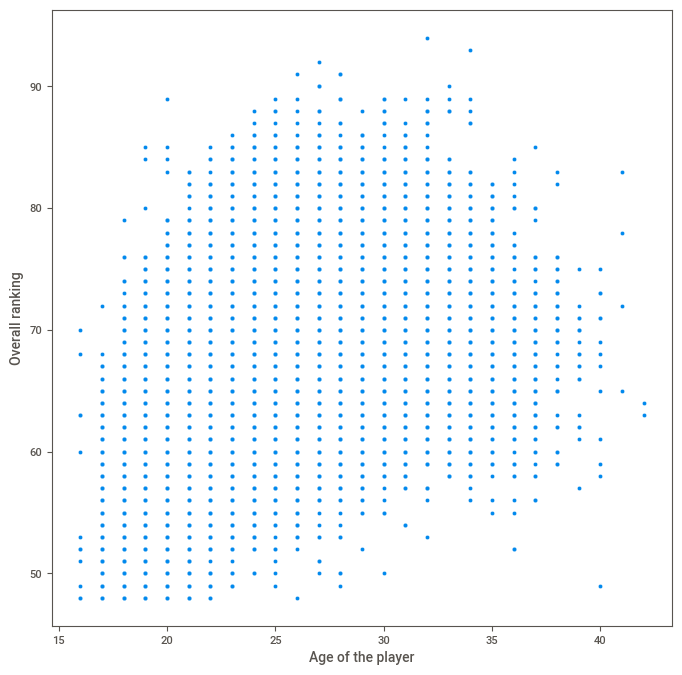

In [190]:
plt.figure(figsize=(8,8))
sns.scatterplot(data=data,x="age", y="overall" )
plt.xlabel("Age of the player")
plt.ylabel("Overall ranking")
plt.show()

* Players stops improving after the age of 34. Overall ranking is reduced from the age of 35

 Qn: Which type of offensive players tends to get paid the most: the striker, the right-winger, or the left-winger?

 Position of the players on the pitch which determines their roles and responsibilities in the team. Forward positions in the football and FIFA 19 can be grouped as striker (ST: center striker, RS: right striker, LS: left striker), forward (CF: center forward, RF: right forward, LF: left forward) and winger (RW: right winger, LW: left winger)


In [191]:
pd.DataFrame(data['player_positions'].value_counts())

,player_positions
CB,2322
GK,2036
ST,1809
CM,786
"CDM, CM",731
...,...
"LM, LWB, CM",1
"CAM, CDM, CB",1
"RM, LB",1
"LB, CDM, LWB",1


In [192]:
# Extract players who play in Striker position
striker = data.loc[data["player_positions"].str.contains("ST")]


# Extract players who play in Right wing position
right_winger = data.loc[data["player_positions"].str.contains("RW")]

# Extract players who play in Left wing position
left_winger = data.loc[data["player_positions"].str.contains("LW")]

# Concatenate the data
positions = pd.concat([striker,right_winger,left_winger], axis=0, ignore_index=True)
positions


,sofifa_id,player_url,short_name,long_name,age,dob,height_cm,weight_kg,nationality,club,...,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb
0,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,32,1987-06-24,170,72,Argentina,FC Barcelona,...,68+2,66+2,66+2,66+2,68+2,63+2,52+2,52+2,52+2,63+2
1,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,34,1985-02-05,187,83,Portugal,Juventus,...,65+3,61+3,61+3,61+3,65+3,61+3,53+3,53+3,53+3,61+3
2,209331,https://sofifa.com/player/209331/mohamed-salah...,M. Salah,Mohamed Salah Ghaly,27,1992-06-15,175,71,Egypt,Liverpool,...,70+3,67+3,67+3,67+3,70+3,66+3,57+3,57+3,57+3,66+3
3,231747,https://sofifa.com/player/231747/kylian-mbappe...,K. Mbappé,Kylian Mbappé,20,1998-12-20,178,73,France,Paris Saint-Germain,...,66+3,62+3,62+3,62+3,66+3,63+3,54+3,54+3,54+3,63+3
4,202126,https://sofifa.com/player/202126/harry-kane/20...,H. Kane,Harry Kane,25,1993-07-28,188,89,England,Tottenham Hotspur,...,65+3,66+3,66+3,66+3,65+3,62+3,60+3,60+3,60+3,62+3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5805,251548,https://sofifa.com/player/251548/paul-osew/20/...,P. Osew,Paul Osew,18,2001-01-05,168,68,England,AFC Wimbledon,...,48+2,43+2,43+2,43+2,48+2,49+2,47+2,47+2,47+2,49+2
5806,247194,https://sofifa.com/player/247194/minwen-jiang/...,Jiang Minwen,Minwen Jiang,22,1997-06-16,177,72,China PR,Wuhan Zall,...,47+2,46+2,46+2,46+2,47+2,47+2,44+2,44+2,44+2,47+2
5807,252483,https://sofifa.com/player/252483/alfie-doughty...,A. Doughty,Alfie Doughty,19,1999-12-21,175,68,England,Charlton Athletic,...,48+2,42+2,42+2,42+2,48+2,48+2,46+2,46+2,46+2,48+2
5808,248360,https://sofifa.com/player/248360/tobias-klysne...,T. Klysner,Tobias Klysner,17,2001-07-03,170,69,Denmark,Randers FC,...,38+2,35+2,35+2,35+2,38+2,36+2,32+2,32+2,32+2,36+2


In [193]:
# Create a function to split the positions into separate columns

def player_positions(position):
    posn_len = len(position)
    global posn1,posn2,posn3

    if (posn_len == 2 or posn_len == 3):
        posn1 = position
        posn2 = posn3 = ''
    elif (posn_len >= 4 and posn_len <=8):
        posn1, posn2 = position.split(",")
        posn3 = ''
    else:
        posn1, posn2,posn3 = position.split(",")

In [194]:
# Split each player position into separate column

for i in range(0,len(positions)):
    positions.loc[i, ["player_positions"]].apply(player_positions)#fun name
    positions.loc[i, ["posn1"]] = posn1
    positions.loc[i, ["posn2"]] = posn2.strip()
    positions.loc[i, ["posn3"]] = posn3.strip()

In [195]:
players = ["ST", "LW", "RW"] # creating a list with st,lw,rw and checking it with separated player positions column

position1 = positions.loc[positions["posn1"].isin(players)]
position2 = positions.loc[positions["posn2"].isin(players)]
position3 = positions.loc[positions["posn3"].isin(players)]

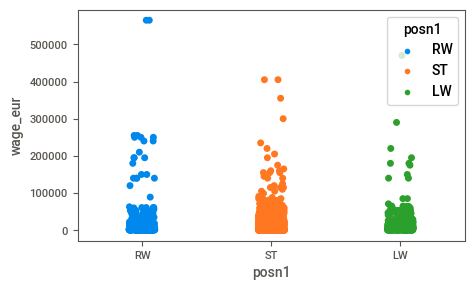

In [196]:
plt.figure(figsize=(5,3))
sns.stripplot(data=position1, x="posn1", y="wage_eur", hue="posn1")
plt.show()

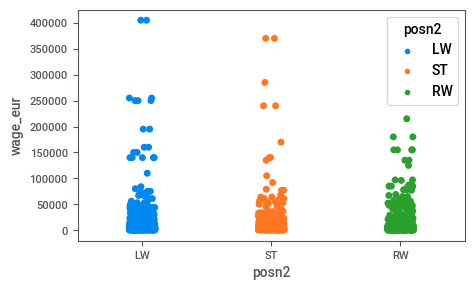

In [197]:
plt.figure(figsize=(5,3))
sns.stripplot(data=position2, x="posn2", y="wage_eur", hue="posn2")
plt.show()

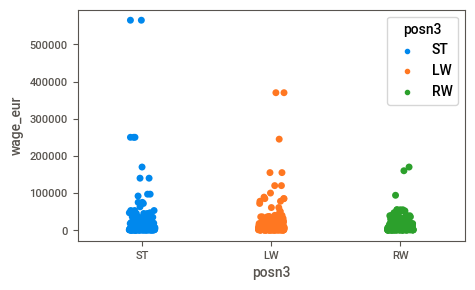

In [198]:
plt.figure(figsize=(5,3))
sns.stripplot(data=position3, x="posn3", y="wage_eur", hue="posn3")
plt.show()

By referring above 3 graph
* Strikers(ST) are paid the highest wage
* Left Wingers(LW) are paid the second most highest wage
* Right Wingers(RW) are paid the least wage when compared with other offensive positions

# 4)Data Preprocessing

In [15]:
nulldata

,0
sofifa_id,0
player_url,0
short_name,0
long_name,0
age,0
...,...
lb,2036
lcb,2036
cb,2036
rcb,2036


Dropping the columns which has null data (loaned_from,'nation_position',player_tags'nation_jersey_number') and irrelevent field
* 'pace','shooting','passing','dribbling','defending','physic',
  'ls','st','rs','lw','lf','cf','rf','rw','lam','cam','ram','lm','lcm','cm','rcm','rm','lwb',	'ldm','cdm','rdm','rwb','lb','player_traits','rb','rcb','cb','lcb','gk_diving','gk_handling','gk_kicking','gk_reflexes','gk_speed','gk_positioning' in these fields the missing values are replaced with 0 beacuse these are the positions  of non_goalkeepers and goal keepers respectively




In [16]:
data1=data.drop(['sofifa_id','overall','player_url','dob','player_tags','team_jersey_number','release_clause_eur','loaned_from','contract_valid_until',
                 'nation_position','nation_jersey_number'],axis=1)


In [17]:
data1.columns

Index(['short_name', 'long_name', 'age', 'height_cm', 'weight_kg',
       'nationality', 'club', 'potential', 'value_eur', 'wage_eur',
       'player_positions', 'preferred_foot', 'international_reputation',
       'weak_foot', 'skill_moves', 'work_rate', 'body_type', 'real_face',
       'team_position', 'joined', 'pace', 'shooting', 'passing', 'dribbling',
       'defending', 'physic', 'gk_diving', 'gk_handling', 'gk_kicking',
       'gk_reflexes', 'gk_speed', 'gk_positioning', 'player_traits',
       'attacking_crossing', 'attacking_finishing',
       'attacking_heading_accuracy', 'attacking_short_passing',
       'attacking_volleys', 'skill_dribbling', 'skill_curve',
       'skill_fk_accuracy', 'skill_long_passing', 'skill_ball_control',
       'movement_acceleration', 'movement_sprint_speed', 'movement_agility',
       'movement_reactions', 'movement_balance', 'power_shot_power',
       'power_jumping', 'power_stamina', 'power_strength', 'power_long_shots',
       'mentality_aggres

deleting features that are not important for model building
* -- only football skills and positions features are keeping for model building
* --  also deleting features start with goalkeeping beacuse we already have those features starting with gk
* --dropping the faeture player_positions beacuse in data description it says this data field is not requried for modelling

In [18]:
df=data1.drop(['short_name', 'long_name', 'nationality','club', 'potential', 'value_eur', 'wage_eur', 'player_positions',
               'international_reputation', 'weak_foot', 'body_type', 'real_face','team_position','joined','player_traits','skill_moves',
              'goalkeeping_diving','goalkeeping_handling', 'goalkeeping_kicking','goalkeeping_positioning', 'goalkeeping_reflexes'],axis=1)

In [19]:
df.columns

Index(['age', 'height_cm', 'weight_kg', 'preferred_foot', 'work_rate', 'pace',
       'shooting', 'passing', 'dribbling', 'defending', 'physic', 'gk_diving',
       'gk_handling', 'gk_kicking', 'gk_reflexes', 'gk_speed',
       'gk_positioning', 'attacking_crossing', 'attacking_finishing',
       'attacking_heading_accuracy', 'attacking_short_passing',
       'attacking_volleys', 'skill_dribbling', 'skill_curve',
       'skill_fk_accuracy', 'skill_long_passing', 'skill_ball_control',
       'movement_acceleration', 'movement_sprint_speed', 'movement_agility',
       'movement_reactions', 'movement_balance', 'power_shot_power',
       'power_jumping', 'power_stamina', 'power_strength', 'power_long_shots',
       'mentality_aggression', 'mentality_interceptions',
       'mentality_positioning', 'mentality_vision', 'mentality_penalties',
       'mentality_composure', 'defending_marking', 'defending_standing_tackle',
       'defending_sliding_tackle', 'ls', 'st', 'rs', 'lw', 'lf', 'cf', 'r

--->Handling with missing values

In [20]:
pd.DataFrame(df.isnull().sum())

,0
age,0
height_cm,0
weight_kg,0
preferred_foot,0
work_rate,0
...,...
lb,2036
lcb,2036
cb,2036
rcb,2036


In [21]:
print(df[['pace','shooting','passing','dribbling','defending','physic',
             'ls','st','rs','lw','lf','cf','rf','rw','lam','cam','ram','lm','lcm','cm','rcm','rm','lwb',	'ldm','cdm','rdm','rwb','lb',
           'rb','rcb','cb','lcb','gk_diving','gk_handling','gk_kicking','gk_reflexes','gk_speed','gk_positioning']].dtypes)

pace              float64
shooting          float64
passing           float64
dribbling         float64
defending         float64
physic            float64
ls                 object
st                 object
rs                 object
lw                 object
lf                 object
cf                 object
rf                 object
rw                 object
lam                object
cam                object
ram                object
lm                 object
lcm                object
cm                 object
rcm                object
rm                 object
lwb                object
ldm                object
cdm                object
rdm                object
rwb                object
lb                 object
rb                 object
rcb                object
cb                 object
lcb                object
gk_diving         float64
gk_handling       float64
gk_kicking        float64
gk_reflexes       float64
gk_speed          float64
gk_positioning    float64
dtype: objec

handling missing values in 'pace','shooting','passing','dribbling','defending','physic' others will be handle  during convertion

In [22]:
dat=df[['pace','shooting','passing','dribbling','defending','physic']]
for i in dat:
    df.loc[df[i].isna() == True, i] = 0

In [23]:
dat.isnull().sum()

pace         2036
shooting     2036
passing      2036
dribbling    2036
defending    2036
physic       2036
dtype: int64

In [24]:
df.shape

(18278, 72)

# outlier handling

In [25]:
num_data=df.select_dtypes(include=["int64","float64"])
print(num_data.columns)
print(num_data.shape)


Index(['age', 'height_cm', 'weight_kg', 'pace', 'shooting', 'passing',
       'dribbling', 'defending', 'physic', 'gk_diving', 'gk_handling',
       'gk_kicking', 'gk_reflexes', 'gk_speed', 'gk_positioning',
       'attacking_crossing', 'attacking_finishing',
       'attacking_heading_accuracy', 'attacking_short_passing',
       'attacking_volleys', 'skill_dribbling', 'skill_curve',
       'skill_fk_accuracy', 'skill_long_passing', 'skill_ball_control',
       'movement_acceleration', 'movement_sprint_speed', 'movement_agility',
       'movement_reactions', 'movement_balance', 'power_shot_power',
       'power_jumping', 'power_stamina', 'power_strength', 'power_long_shots',
       'mentality_aggression', 'mentality_interceptions',
       'mentality_positioning', 'mentality_vision', 'mentality_penalties',
       'mentality_composure', 'defending_marking', 'defending_standing_tackle',
       'defending_sliding_tackle'],
      dtype='object')
(18278, 44)


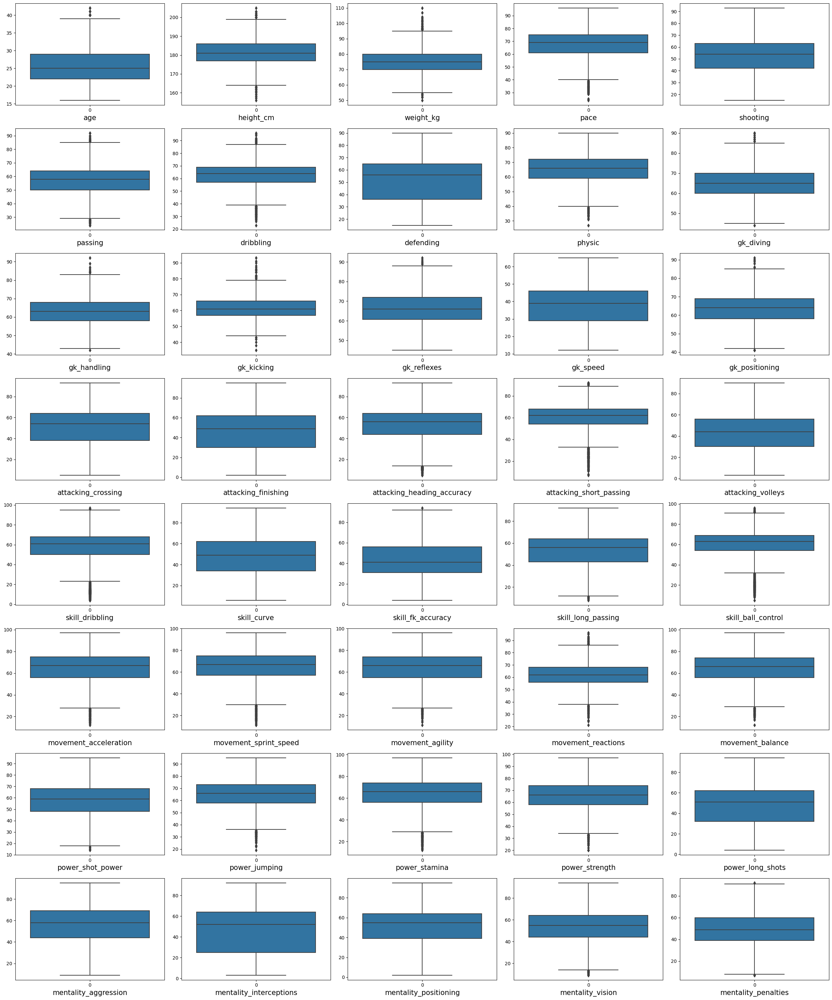

In [26]:
plt.figure(figsize=(25,30),facecolor='white')

plotnumber=1

for column in num_data:
    if plotnumber<=40 :
        ax=plt.subplot(8,5,plotnumber)
        sns.boxplot(data[column])
        plt.xlabel(column,fontsize=15)
    plotnumber+=1
plt.tight_layout()

In [27]:
from scipy import stats

In [28]:
for i in num_data:
         IQR = stats.iqr(num_data[i], interpolation = 'midpoint')
         Q1 = num_data[i].quantile(0.25)
         Q3 =num_data[i].quantile(0.75)
         min_limit=Q1 - 1.5*IQR
         max_limit=Q3 +1.5*IQR
         print(i)
         print('lwlmt',min_limit)
         print('uplmt',max_limit)
         print('percentage of uplmt',len(num_data.loc[num_data[i] > max_limit])/len(df)*100)
         print('percentage of lwlmt',len(num_data.loc[num_data[i] < min_limit])/len(df)*100)
         s= len(num_data.loc[num_data[i] > max_limit])/len(df)*100 + len(num_data.loc[num_data[i] < min_limit])/len(df)*100
         print('outlier percentage:',s)
         if s<=5.0:
          print("median is {}".format( df[i].median()))
          df.loc[df[i]<min_limit,i]=df[i].median()
          df.loc[df[i]>max_limit,i]=df[i].median()
         print("**********************")

age
lwlmt 11.5
uplmt 39.5
percentage of uplmt 0.10395010395010396
percentage of lwlmt 0.0
outlier percentage: 0.10395010395010396
median is 25.0
**********************
height_cm
lwlmt 163.5
uplmt 199.5
percentage of uplmt 0.1750738592843856
percentage of lwlmt 0.31185031185031187
outlier percentage: 0.48692417113469744
median is 181.0
**********************
weight_kg
lwlmt 55.0
uplmt 95.0
percentage of uplmt 0.3392056023634971
percentage of lwlmt 0.06018163912900754
outlier percentage: 0.39938724149250465
median is 75.0
**********************
pace
lwlmt 31.5
uplmt 99.5
percentage of uplmt 0.0
percentage of lwlmt 11.412627202100886
outlier percentage: 11.412627202100886
**********************
shooting
lwlmt -5.5
uplmt 102.5
percentage of uplmt 0.0
percentage of lwlmt 0.0
outlier percentage: 0.0
median is 52.0
**********************
passing
lwlmt 20.5
uplmt 88.5
percentage of uplmt 0.02735529051318525
percentage of lwlmt 11.139074296969035
outlier percentage: 11.16642958748222
**********

* data which have less than 5% of outliers are handled with median

# convertion

Converting players positions into numerical form


In [29]:
c=df[['ls','st','rs','lw','lf','cf','rf','rw','lam','cam','ram','lm','lcm','cm','rcm','rm','lwb',	'ldm','cdm','rdm','rwb','lb',
           'rb','rcb','cb','lcb']]

In [30]:
c.isnull().sum()

ls     2036
st     2036
rs     2036
lw     2036
lf     2036
cf     2036
rf     2036
rw     2036
lam    2036
cam    2036
ram    2036
lm     2036
lcm    2036
cm     2036
rcm    2036
rm     2036
lwb    2036
ldm    2036
cdm    2036
rdm    2036
rwb    2036
lb     2036
rb     2036
rcb    2036
cb     2036
lcb    2036
dtype: int64

In [31]:
import re

In [32]:
cat=df[['ls','st','rs','lw','lf','cf','rf','rw','lam','cam','ram','lm','lcm','cm','rcm','rm','lwb',	'ldm','cdm','rdm','rwb','lb',
          'rb','rcb','cb','lcb','gk_diving','gk_handling','gk_kicking','gk_reflexes','gk_speed','gk_positioning']]


In [33]:
for i in cat:
    df.loc[data1[i].isna() == True, i].fillna('0+0') #imputing missing values with 0+0

In [34]:
#creating a function to converting the data in cat into numerical using re(regular expression) module
def c_data(cols):
    if cols is np.nan:
      return 0

    cols_spl = re.split('[-+]', cols)
    col_val_int = list(map(int, cols_spl))
    if "+" in cols:
        return sum(col_val_int)
    else :
       return sub(col_val_int)
    return np.abs(np.diff(col_val_int))

In [35]:
for i in c:
   df[i] = df[i].apply(c_data)


In [36]:
df.head()

,age,height_cm,weight_kg,preferred_foot,work_rate,pace,shooting,passing,dribbling,defending,...,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb
0,32,170,72,Left,Medium/Low,87.0,92.0,92.0,96.0,39.0,...,70,68,68,68,70,65,54,54,54,65
1,34,187,83,Right,High/Low,90.0,93.0,82.0,89.0,35.0,...,68,64,64,64,68,64,56,56,56,64
2,27,175,68,Right,High/Medium,91.0,85.0,87.0,95.0,32.0,...,69,64,64,64,69,64,49,49,49,64
3,26,188,87,Right,Medium/Medium,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0
4,28,175,74,Right,High/Medium,91.0,83.0,86.0,94.0,35.0,...,69,66,66,66,69,64,52,52,52,64


In [37]:
df.isnull().sum()

age               0
height_cm         0
weight_kg         0
preferred_foot    0
work_rate         0
                 ..
lb                0
lcb               0
cb                0
rcb               0
rb                0
Length: 72, dtype: int64

# Label encoder

In [38]:
df.select_dtypes(include='O')

,preferred_foot,work_rate
0,Left,Medium/Low
1,Right,High/Low
2,Right,High/Medium
3,Right,Medium/Medium
4,Right,High/Medium
...,...,...
18273,Right,Medium/High
18274,Right,Medium/Medium
18275,Right,Low/Medium
18276,Right,Low/Low


In [39]:
df['work_rate'].value_counts()

Medium/Medium    9875
High/Medium      3216
Medium/High      1718
High/High         986
Medium/Low        886
High/Low          684
Low/Medium        461
Low/High          417
Low/Low            35
Name: work_rate, dtype: int64

In [40]:
from sklearn.preprocessing import LabelEncoder
le=LabelEncoder()

df.preferred_foot=le.fit_transform(df.preferred_foot)


In [41]:
en={'work_rate':{"Medium/Medium" :8 ,"High/Medium" :7,"Medium/High":6,'High/High':5,'Medium/Low':4,'High/Low' :3,'Low/Medium' :2,'Low/High' :1,'Low/Low':0}}

In [42]:
df = df.replace(en)
df.head()

,age,height_cm,weight_kg,preferred_foot,work_rate,pace,shooting,passing,dribbling,defending,...,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb
0,32,170,72,0,4,87.0,92.0,92.0,96.0,39.0,...,70,68,68,68,70,65,54,54,54,65
1,34,187,83,1,3,90.0,93.0,82.0,89.0,35.0,...,68,64,64,64,68,64,56,56,56,64
2,27,175,68,1,7,91.0,85.0,87.0,95.0,32.0,...,69,64,64,64,69,64,49,49,49,64
3,26,188,87,1,8,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0
4,28,175,74,1,7,91.0,83.0,86.0,94.0,35.0,...,69,66,66,66,69,64,52,52,52,64


# Dataset

In [43]:
df.to_csv('capstone2fifa_prepro.csv')

In [44]:
fifa_data=pd.read_csv('/content/gdrive/My Drive/capstone project/fifa_20/capstone2fifa_prepro.csv')

In [45]:
fifa_data.head()

,Unnamed: 0,age,height_cm,weight_kg,preferred_foot,work_rate,pace,shooting,passing,dribbling,...,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb
0,0,32,170,72,0,4,87.0,92.0,92.0,96.0,...,70,68,68,68,70,65,54,54,54,65
1,1,34,187,83,1,3,90.0,93.0,82.0,89.0,...,68,64,64,64,68,64,56,56,56,64
2,2,27,175,68,1,7,91.0,85.0,87.0,95.0,...,69,64,64,64,69,64,49,49,49,64
3,3,26,188,87,1,8,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0
4,4,28,175,74,1,7,91.0,83.0,86.0,94.0,...,69,66,66,66,69,64,52,52,52,64


In [46]:
fifa_data.drop(['Unnamed: 0'],axis=1,inplace=True)

<Axes: >

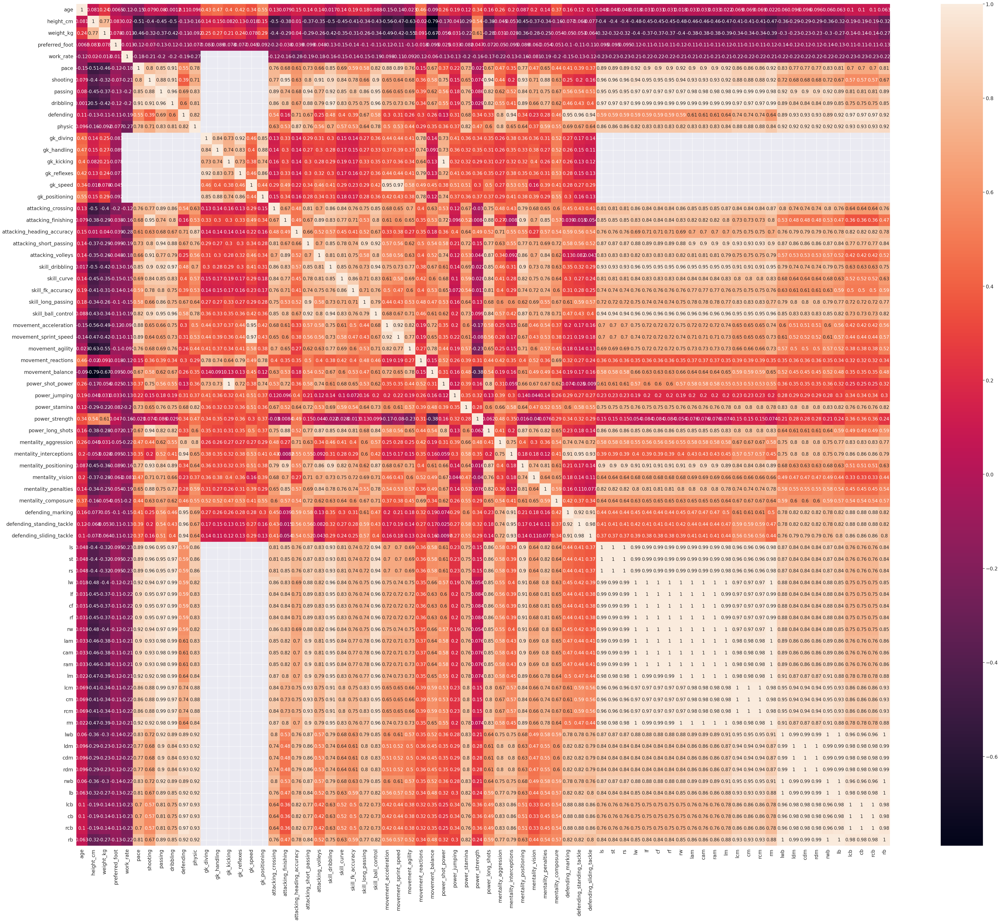

In [47]:
plt.figure(figsize=(60,50))
sns.set(font_scale=1.5)
sns.heatmap(fifa_data.corr(),annot=True, annot_kws={"size":15})

* most of the features are highly correlated  so removing them will loss of data

In [48]:
fifa_data.loc[fifa_data.duplicated()]

,age,height_cm,weight_kg,preferred_foot,work_rate,pace,shooting,passing,dribbling,defending,...,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb
566,35,177,75,1,5,68.0,62.0,74.0,76.0,78.0,...,79,80,80,80,79,79,77,77,77,79


In [49]:
fifa_data.drop_duplicates()

,age,height_cm,weight_kg,preferred_foot,work_rate,pace,shooting,passing,dribbling,defending,...,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb
0,32,170,72,0,4,87.0,92.0,92.0,96.0,39.0,...,70,68,68,68,70,65,54,54,54,65
1,34,187,83,1,3,90.0,93.0,82.0,89.0,35.0,...,68,64,64,64,68,64,56,56,56,64
2,27,175,68,1,7,91.0,85.0,87.0,95.0,32.0,...,69,64,64,64,69,64,49,49,49,64
3,26,188,87,1,8,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0
4,28,175,74,1,7,91.0,83.0,86.0,94.0,35.0,...,69,66,66,66,69,64,52,52,52,64
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18273,22,186,79,1,6,57.0,23.0,28.0,33.0,47.0,...,45,44,44,44,45,47,48,48,48,47
18274,22,177,66,1,8,58.0,24.0,33.0,35.0,48.0,...,46,45,45,45,46,48,49,49,49,48
18275,19,186,75,1,2,54.0,35.0,44.0,45.0,48.0,...,49,51,51,51,49,49,51,51,51,49
18276,18,185,74,1,0,59.0,35.0,47.0,47.0,45.0,...,50,50,50,50,50,50,51,51,51,50


# Feature Extraction

In [50]:
null_vals=np.any(np.isnan(fifa_data))


In [51]:
for i in fifa_data:
      fifa_data.loc[fifa_data[i].isna()== True,i]=0


In [52]:
np.any(np.isnan(fifa_data))

False

In [53]:
from sklearn.preprocessing import StandardScaler
stanscale=StandardScaler()
df=stanscale.fit_transform(fifa_data)

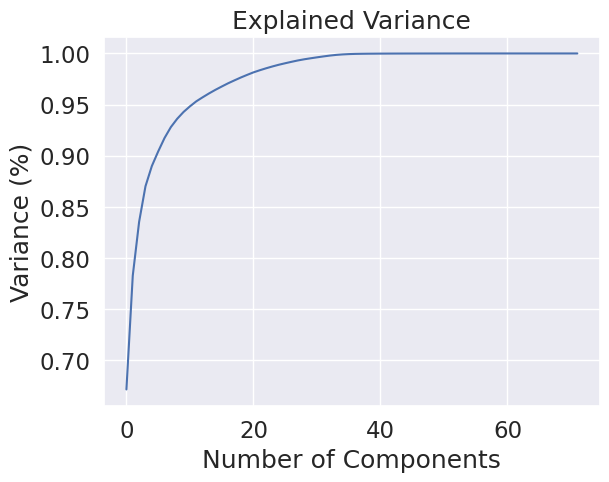

In [54]:
from sklearn.decomposition import PCA
pca = PCA()
principalComponents = pca.fit_transform(df)
plt.figure()
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Components')
plt.ylabel('Variance (%)') #for each component
plt.title('Explained Variance')
plt.show()

10 components explains almost 95% of data

In [55]:
pca = PCA(n_components=10)
new_data = pca.fit_transform(df)
# This will be the new data fed to the algorithm.
principal_Df = pd.DataFrame(data = new_data, columns = ['pca1','pca2','pca3','pca4','pca5','pca6','pca7','pca8','pca9','pca10'])

In [56]:
principal_Df.head()

,pca1,pca2,pca3,pca4,pca5,pca6,pca7,pca8,pca9,pca10
0,-11.335823,-6.449101,4.236010,-2.363018,-0.410105,-0.696744,1.870667,-0.619603,-0.313675,1.391569
1,-10.383411,-5.043369,6.199849,1.006962,-2.970297,0.204627,0.616363,-0.877858,-0.497627,0.791287
2,-10.082240,-6.965570,2.850978,-2.062873,-0.242355,0.153827,-0.844572,-0.982305,0.011976,1.502710
3,17.472432,-1.137985,5.001805,-3.819609,-3.257813,-0.819373,-1.169128,-1.676529,-1.247867,1.021933
4,-10.019706,-6.213770,3.118272,-1.664682,-0.426239,-0.064738,-0.973847,-1.214664,0.556206,1.291178


In [57]:
X=principal_Df.iloc[:,0:10]

In [58]:
X.shape

(18278, 10)

### Model building

In [59]:
from sklearn.cluster import KMeans

In [60]:
wcss=[]
for i in range(2,11):
    model=KMeans(n_clusters=i,random_state=40)
    model.fit(X)
    wcss.append(model.inertia_)
    print(model.inertia_)

480442.0331156653
357901.41095190716
281430.06812272244
251794.73768166144
230642.04626399826
215635.38467850452
201647.96408252788
192167.45773787895
183746.6252237857


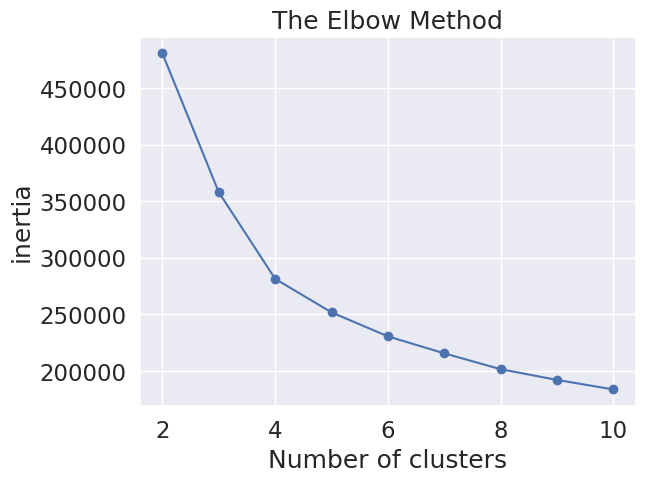

In [61]:
plt.plot(range(2,11),wcss,'-o')
plt.title('The Elbow Method')
plt.xlabel("Number of clusters")
plt.ylabel('inertia')
plt.show()

number of clusters showing is 4

In [62]:
model=KMeans(n_clusters=4,random_state=10)
model.fit(X)

KMeans(n_clusters=4, random_state=10)

In [63]:
from sklearn.metrics import silhouette_score

silhouette_score(X,model.labels_)

0.30789679904275197

cluster visualizing

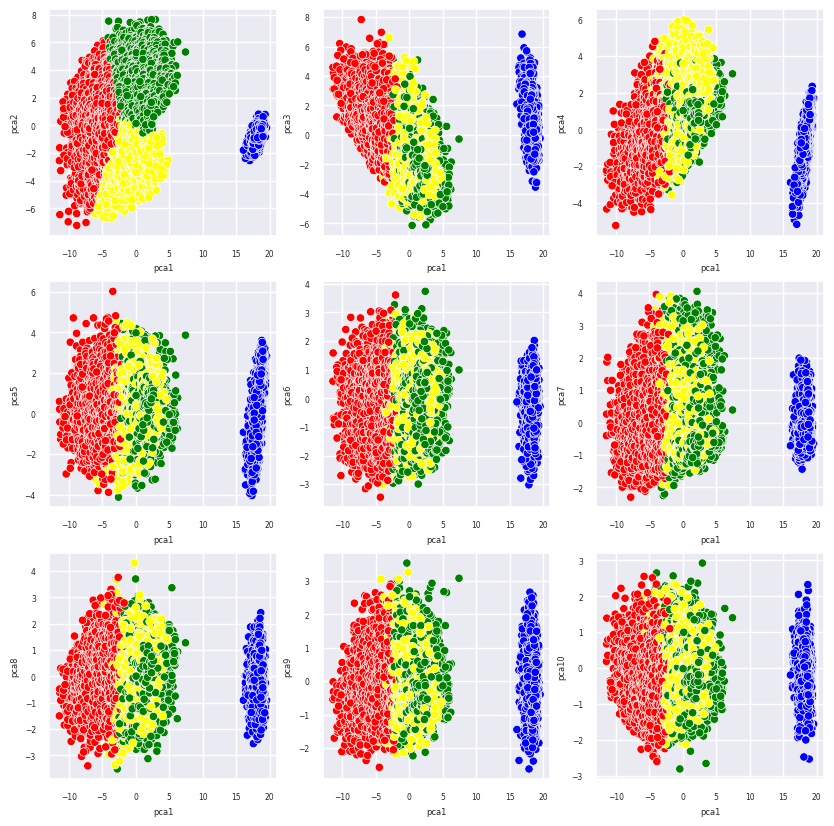

In [89]:
clr = np.array(["red", "blue", "green", "yellow", "black"])
sns.set(font_scale=0.5)

clm=principal_Df[['pca2','pca3','pca4','pca5','pca6','pca7','pca8','pca9','pca10']]
plt.figure(figsize=(10,10))
plt_num = 1
for i in clm:
  if plt_num<=9:
     plt.subplot(3,3,plt_num)
     sns.scatterplot(data=principal_Df,x='pca1',y=clm[i],color=clr[model.labels_])
  plt_num +=1
plt.show()

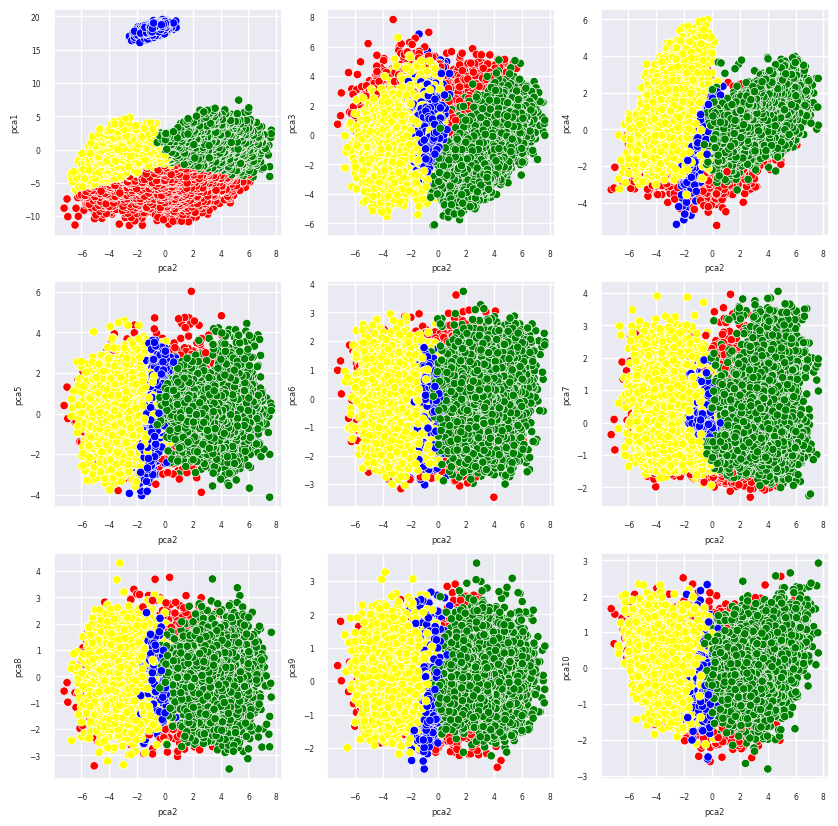

In [90]:
clm=principal_Df[['pca1','pca3','pca4','pca5','pca6','pca7','pca8','pca9','pca10']]
plt.figure(figsize=(10,10))
plt_num = 1
for i in clm:
  if plt_num<=9:
     plt.subplot(3,3,plt_num)
     sns.scatterplot(data=principal_Df,x='pca2',y=clm[i],color=clr[model.labels_])
  plt_num +=1
plt.show()

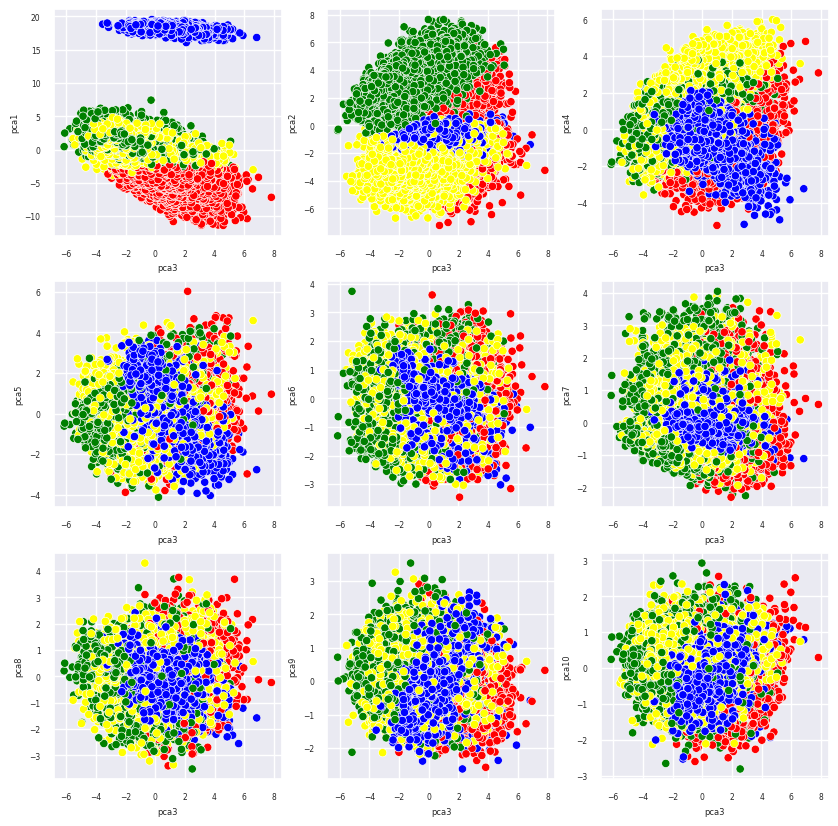

In [91]:
clm=principal_Df[['pca1','pca2','pca4','pca5','pca6','pca7','pca8','pca9','pca10']]
plt.figure(figsize=(10,10))
plt_num = 1
for i in clm:
  if plt_num<=9:
     plt.subplot(3,3,plt_num)
     sns.scatterplot(data=principal_Df,x='pca3',y=clm[i],color=clr[model.labels_])
  plt_num +=1
plt.show()

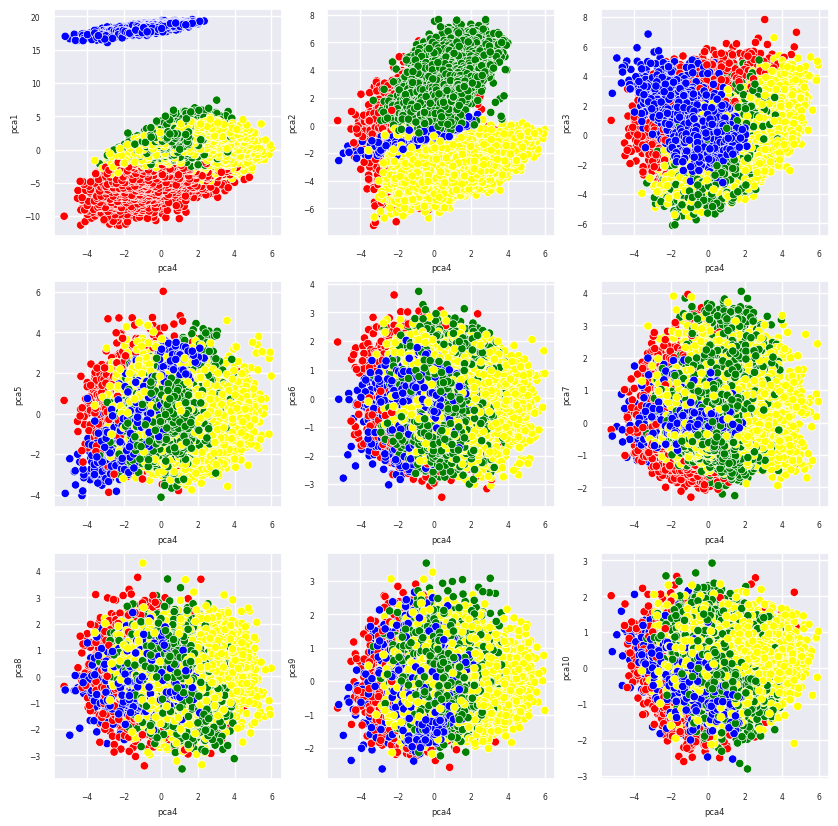

In [92]:
clm=principal_Df[['pca1','pca2','pca3','pca5','pca6','pca7','pca8','pca9','pca10']]
plt.figure(figsize=(10,10))
plt_num = 1
for i in clm:
  if plt_num<=9:
     plt.subplot(3,3,plt_num)
     sns.scatterplot(data=principal_Df,x='pca4',y=clm[i],color=clr[model.labels_])
  plt_num +=1
plt.show()

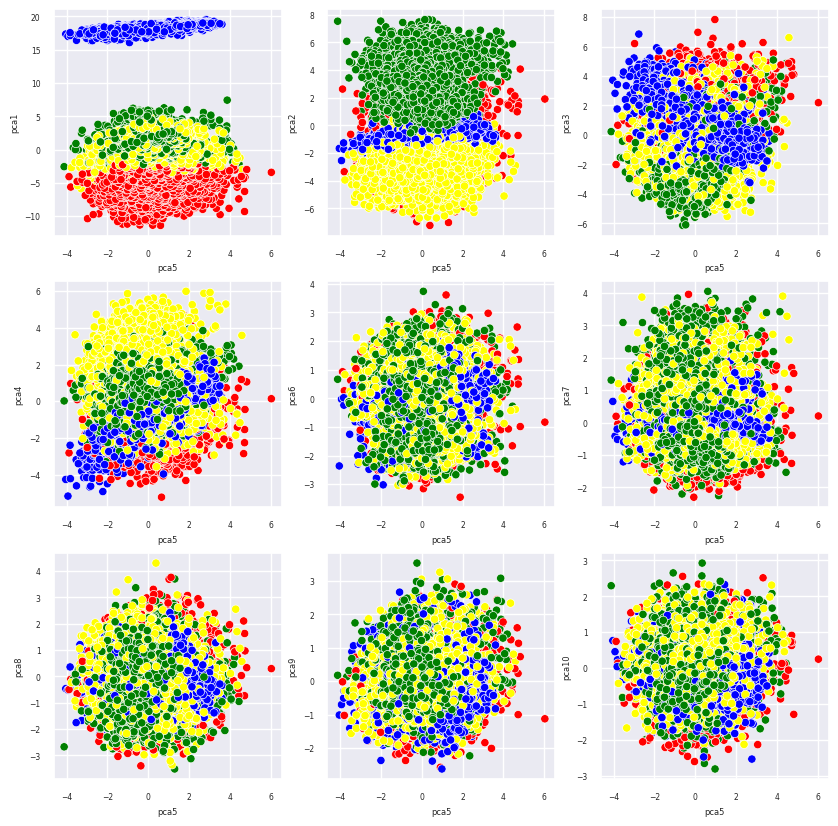

In [93]:
clm=principal_Df[['pca1','pca2','pca3','pca4','pca6','pca7','pca8','pca9','pca10']]
plt.figure(figsize=(10,10))
plt_num = 1
for i in clm:
  if plt_num<=9:
     plt.subplot(3,3,plt_num)
     sns.scatterplot(data=principal_Df,x='pca5',y=clm[i],color=clr[model.labels_])
  plt_num +=1
plt.show()

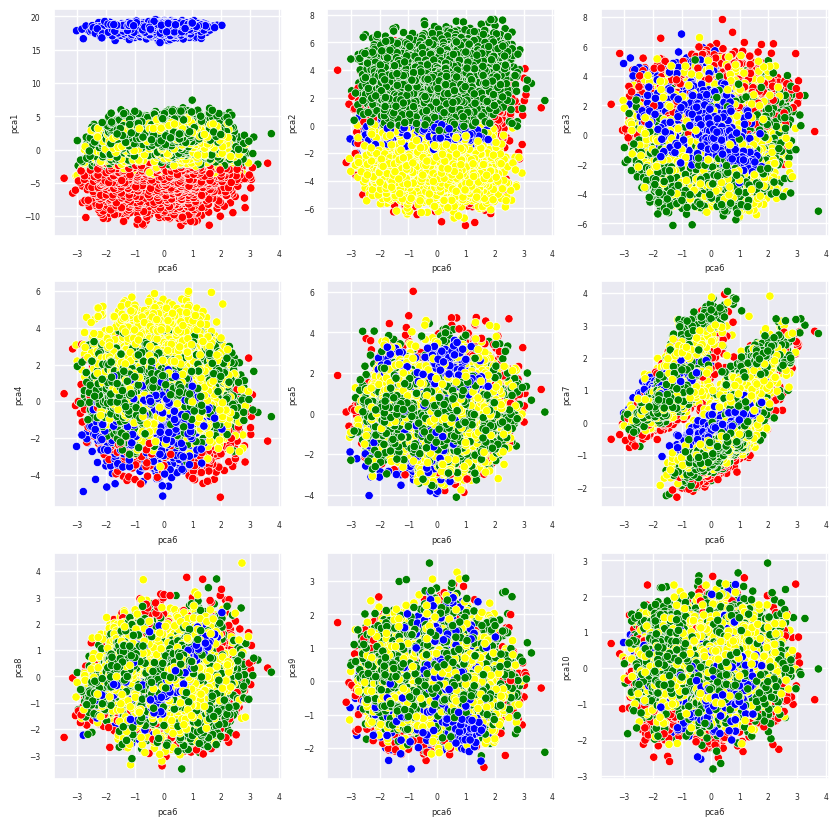

In [94]:
clm=principal_Df[['pca1','pca2','pca3','pca4','pca5','pca7','pca8','pca9','pca10']]
plt.figure(figsize=(10,10))
plt_num = 1
for i in clm:
  if plt_num<=9:
     plt.subplot(3,3,plt_num)
     sns.scatterplot(data=principal_Df,x='pca6',y=clm[i],color=clr[model.labels_])
  plt_num +=1
plt.show()

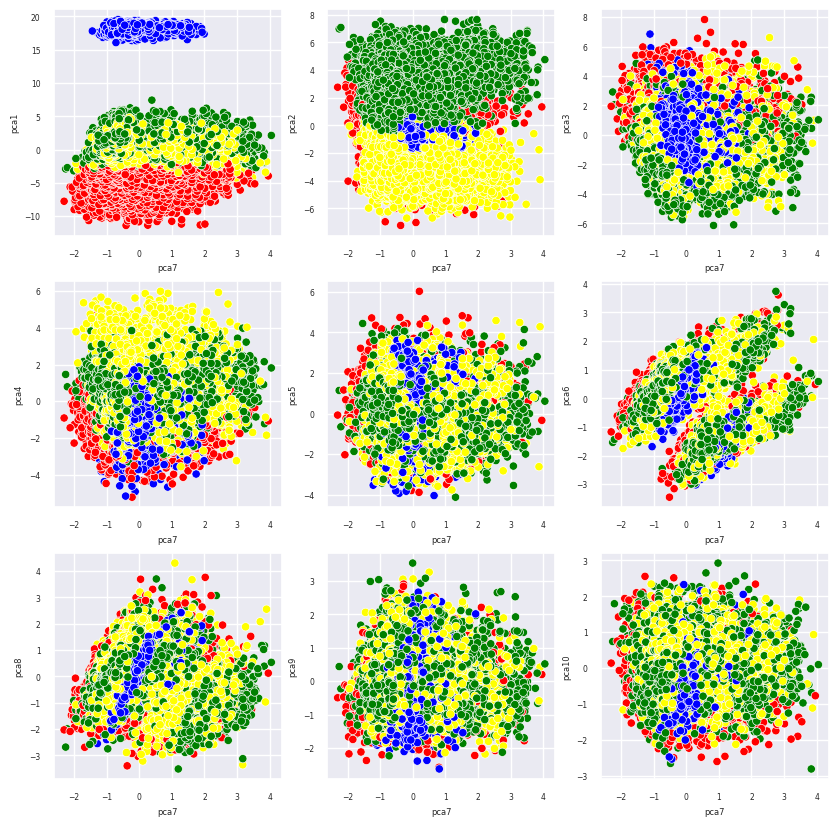

In [95]:
clm=principal_Df[['pca1','pca2','pca3','pca4','pca5','pca6','pca8','pca9','pca10']]
plt.figure(figsize=(10,10))
plt_num = 1
for i in clm:
  if plt_num<=9:
     plt.subplot(3,3,plt_num)
     sns.scatterplot(data=principal_Df,x='pca7',y=clm[i],color=clr[model.labels_])
  plt_num +=1
plt.show()

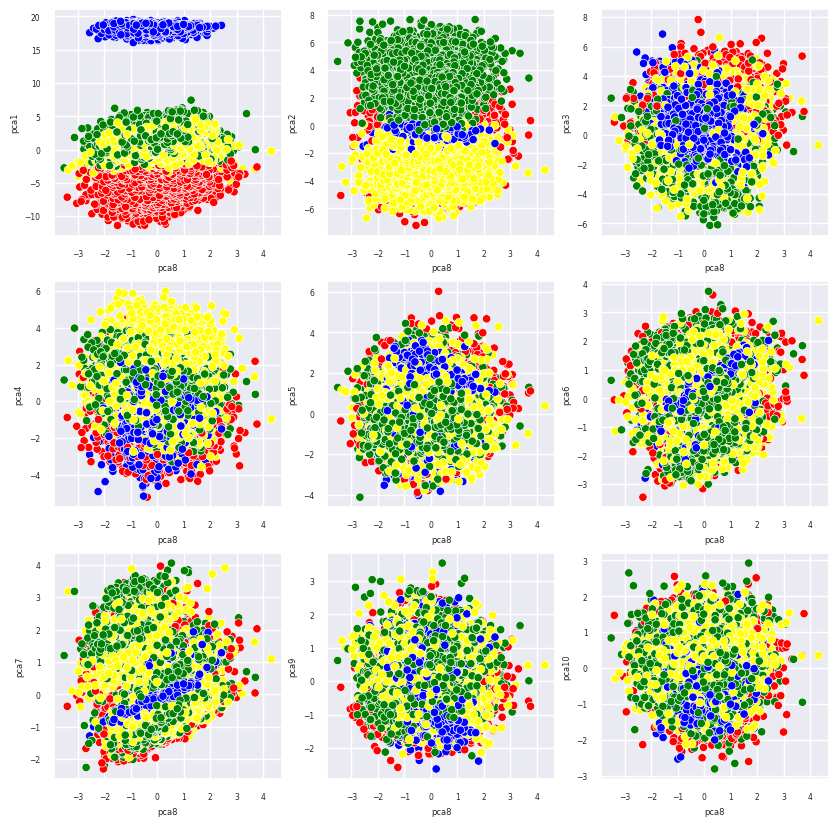

In [96]:
clm=principal_Df[['pca1','pca2','pca3','pca4','pca5','pca6','pca7','pca9','pca10']]
plt.figure(figsize=(10,10))
plt_num = 1
for i in clm:
  if plt_num<=9:
     plt.subplot(3,3,plt_num)
     sns.scatterplot(data=principal_Df,x='pca8',y=clm[i],color=clr[model.labels_])
  plt_num +=1
plt.show()

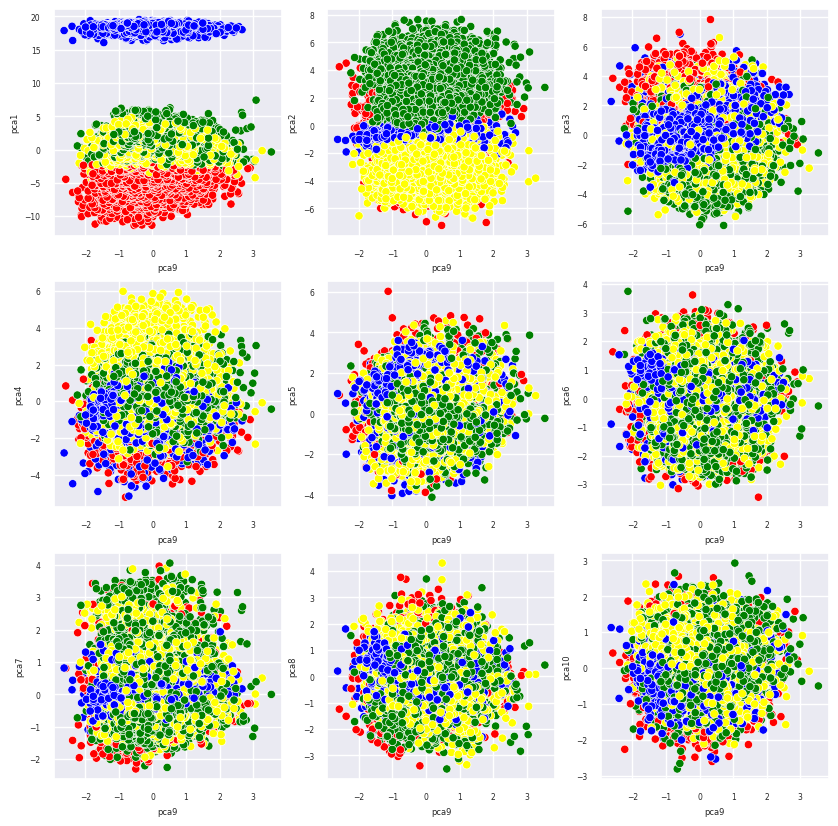

In [97]:
clm=principal_Df[['pca1','pca2','pca3','pca4','pca5','pca6','pca7','pca8','pca10']]
plt.figure(figsize=(10,10))
plt_num = 1
for i in clm:
  if plt_num<=9:
     plt.subplot(3,3,plt_num)
     sns.scatterplot(data=principal_Df,x='pca9',y=clm[i],color=clr[model.labels_])
  plt_num +=1
plt.show()

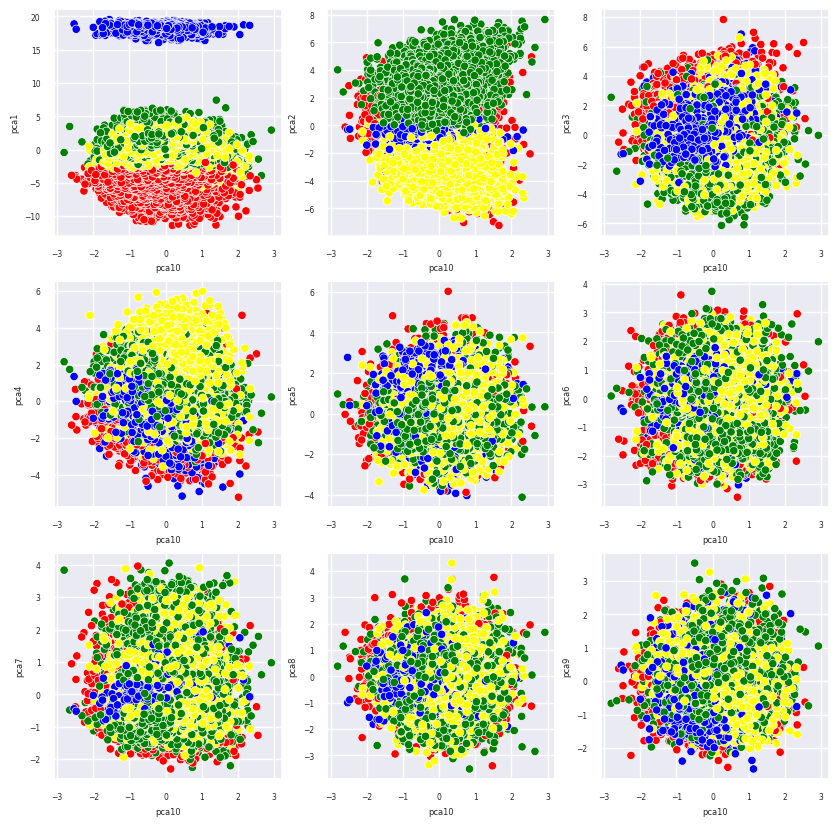

In [98]:
clm=principal_Df[['pca1','pca2','pca3','pca4','pca5','pca6','pca7','pca8','pca9']]
plt.figure(figsize=(10,10))
plt_num = 1
for i in clm:
  if plt_num<=9:
     plt.subplot(3,3,plt_num)
     sns.scatterplot(data=principal_Df,x='pca10',y=clm[i],color=clr[model.labels_])
  plt_num +=1
plt.show()

**Result :**

 * **Optimal cluster size is four and  silhouette_score for the clustering is 0.3078**

**Report:**
 * Domain analysis for the fifa_20 dataset was a difficult and it took lot of time. From a non sports background understanding each skills took lots of strength.
 * Extracting the postions[ST,LW,RW] from player positions  was agreat task it was really complicated so first I created a function to separate each values from the field then created a table and then did analysis with that table
 * Convertion of non_goal keeper players position from string to numerical : in here when I tried to fill the missing valures with 0 it shows error on feature extraction so I filled the missing value with 0+0
 * In this data most features are correlated with each other so can't extract freatures using heatmap and corr() function so here I used PCA for feature extraction

